In [162]:
import numpy as np
import pandas as pd
import plotly.express as px 
import plotly.graph_objects as go
import sklearn
import seaborn as sns

## Repeatedly typing out sklearn functions


### Preprocessing and pipelines

In [235]:
## Imputation of missing values

# impute with simple stats
from sklearn.impute import SimpleImputer
from sklearn.impute import SimpleImputer
from sklearn.impute import SimpleImputer

imputer = SimpleImputer(strategy='median')

#impute with average from similar datapoints
from sklearn.impute import KNNImputer
from sklearn.impute import KNNImputer
from sklearn.impute import KNNImputer

imputer  = KNNImputer(n_neighbors=2, weights='uniform')

## Scaling of data 

# standardization: subtract thge mean and dividde by the std
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()

# Scale by the median and the IQR (robust to outliers): 
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import RobustScaler

scaler = RobustScaler()

## Encoding of categtorical features

# ordinal encoding (attaching a numeric value to each category)
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import OrdinalEncoder

# One hot encoding (dummy variables)  
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import OneHotEncoder

onehot = OneHotEncoder()

## Discretization of continuous features

# Discretize into k bins
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.preprocessing import KBinsDiscretizer

discretizer = KBinsDiscretizer(n_bins = 5, encode = 'onehot', strategy = 'quantile')


## Feature binarization: thesholding numerical features to get boolean values
from sklearn.preprocessing import Binarizer
from sklearn.preprocessing import Binarizer
from sklearn.preprocessing import Binarizer 

binarizer = Binarizer(threshold= 100)

## Generating polynomial features 
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(degree = 2, interaction_only= False, include_bias  = True)

## Custom Transformations 

# converting existing python function into a transformer 
from sklearn.preprocessing import FunctionTransformer
from sklearn. preprocessing import FunctionTransformer
from sklearn.preprocessing import FunctionTransformer
from sklearn.pipeline import make_pipeline

natural_log = FunctionTransformer(function = np.log1p)
square_root = FunctionTransformer(function = np.sqrt)

# create a feature that is the ratio of another column
def ratio(X):
    np.divide(X[:,[0]],X[:,[1]])
def ratio_name(function_transformer, feature_names_in):
    return('ratio')
def ratio_pipeline():
    make_pipeline(
        SimpleImputer(),
        FunctionTransformer(ratio,feature_names_out = ratio_name),
        StandardScaler()
    )


## Constructing pipelines

# using pipeline
from sklearn.pipeline import Pipeline
from sklearn.pipeline import Pipeline
from sklearn.pipeline import pipeline
from sklearn.svm import LinearSVR

pipe = Pipeline(Steps = [
    ('median_imputation', SimpleImputer(strategy='median')),
    ('standardization',StandardScaler()),
    ('svm_regression', LinearSVR())
])

# using make_pipeline: no longer have to specify name sof pipeline steps 
pipe = make_pipeline(
    SimpleImputer(strategy = 'mean'),
    StandardScaler(),
    LinearSVR()
)

# pipeline for a sqaure root trasnsformation
sqrt_pipe = make_pipeline(
    KNNImputer(n_neighbors=3),
    FunctionTransformer(np.sqrt(), feature_names_out = 'one_to_one'),
    StandardScaler()
)

## Using ColumnTransformer to handle applying different transformers to different columns 
from sklearn.compose import ColumnTransformer
from sklearn.compose import ColumnTransformer
from sklearn.compose import ColumnTransformer

numerical_features = ['list of numerical columns']
categorical_features = ['list of categorical columns']

num_pipeline = make_pipeline(SimpleImputer(strategy = 'median'), StandardScaler())
cat_pipeline = make_pipeline(SimpleImputer(strategy = 'most_frequent'))

# using ColumnTransformer
prepocessing = ColumnTransformer([
    ('numerical_processor', num_pipeline, numerical_features),
    ('categorial_processor', cat_pipeline, categorical_features)
])

# using make_column_transformer ans make_column_selector
from sklearn.compose import make_column_selector, make_column_transformer
from sklearn.compose import make_column_selector, make_column_transformer

prepocessing = make_column_transformer(
        (sqrt_pipe, ['list of columns to apply this pipeline to']),
        (num_pipeline, ['list of columns to apply...']),
        (cat_pipeline, make_column_selector(dtype_include=object))
)


IndentationError: expected an indented block (2981014510.py, line 89)

### Model Selection and Validation

In [ ]:
## Splitting data in to train and test sets 

# train test split (totally random but there also exists a stratify option)
from sklearn.model_selection import train_test_split
from sklearn.model_selection import train_test_split
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, ytest_size = .8, random_state = 324)


## Evaluate model scores using cross validation 
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import cross_val_score
from sklearn.svm import LinearSVR


model = LinearSVR(C = 1, random_state = 324)
scores = cross_val_score(model, X_train, y_train, cv = 5, )

# Generate estimates/predictions for each input data point using cross validation (each data point belongs top exactly 1 test set)
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import cross_val_predict

cv_predictions = cross_val_predict(model, X_train, y_train, cv =5, random_state = 324)


## Hyperparamter tuning 

# Grid search 
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import GridSearchCV

params = {'param_name':('values to try sepaerated by commas'),'param_2':[1,4,8]}
grid_search = GridSearchCV(model, params, cv = 5, scoring = 'neg_root_mean_squared_error')
grid_search.fit(X_test, y_test)

# randomized grid search
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint 

param_distribs = {'pipeline_name__param_name': randint(low = 2, high = 20),
                    'estimator_name__param_name': randint(low = 10, high = 100)}

random_search = RandomizedSearchCV(model, param_distributions = param_distribs, n_iter = 10, cv = 5, random_state = 324)

random_search.fit(X_train, y_train)

final_model = random_search.best_estimator_


## Metrics 
https://scikit-learn.org/stable/modules/model_evaluation.html

# Pracicing on Tips Dataset

## Load the data and create the target: tip percent

In [236]:
tips = sns.load_dataset('tips')
tips['tip_percent'] = np.round(100*(tips['tip']/tips['total_bill']),3)

## Basic look at the data

In [237]:
tips.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 244 entries, 0 to 243
Data columns (total 8 columns):
 #   Column       Non-Null Count  Dtype   
---  ------       --------------  -----   
 0   total_bill   244 non-null    float64 
 1   tip          244 non-null    float64 
 2   sex          244 non-null    category
 3   smoker       244 non-null    category
 4   day          244 non-null    category
 5   time         244 non-null    category
 6   size         244 non-null    int64   
 7   tip_percent  244 non-null    float64 
dtypes: category(4), float64(3), int64(1)
memory usage: 9.3 KB


In [238]:
tips.isna().mean()

total_bill     0.0
tip            0.0
sex            0.0
smoker         0.0
day            0.0
time           0.0
size           0.0
tip_percent    0.0
dtype: float64

In [27]:
tips.head()

,total_bill,tip,sex,smoker,day,time,size,tip_percent
0,16.99,1.01,Female,No,Sun,Dinner,2,5.945
1,10.34,1.66,Male,No,Sun,Dinner,3,16.054
2,21.01,3.50,Male,No,Sun,Dinner,3,16.659
3,23.68,3.31,Male,No,Sun,Dinner,2,13.978
4,24.59,3.61,Female,No,Sun,Dinner,4,14.681


## Split the data into test and train sets

In [241]:
X = tips.drop('tip_percent', axis = 1).copy()
y = tips['tip_percent'].copy()

from sklearn.model_selection import train_test_split
X_train, X_test, y_trian, y_test = train_test_split(X, y, test_size= .8, random_state= 324)

# create a copy pf ther test set for exploration and messing around
t = X_test.copy()

## Create a baseline regression model

In [95]:
tipsy_oh = pd.get_dummies(tipsy, columns = ['sex','smoker','day','time'])

from sklearn.linear_model import LinearRegression

X = tipsy_oh.drop(['tip','tip_percent'], axis = 1)
y = tipsy_oh['tip_percent']

baseline_reg = LinearRegression()
baseline_reg.fit(X, y)

LinearRegression()

In [109]:
baseline_pred = baseline_reg.predict(X)

from sklearn.metrics import mean_squared_error 
baseline_rmse = mean_squared_error(y, baseline_pred, squared = False)
print("RMSE on training set:")
baseline_rmse

RMSE on test set:


7.637563406957967

In [115]:
from sklearn.model_selection import cross_val_score 

baseline_rmses = -cross_val_score(baseline_reg, X, y, scoring='neg_root_mean_squared_error', cv = 10)
print("RMSE results from cross vaidation on the training set:")
pd.Series(baseline_rmses).describe()

RMSE results from cross vaidation on the training set:


count    10.000000
mean      8.672963
std       6.118807
min       2.552389
25%       5.155550
50%       6.855900
75%       9.770964
max      23.908104
dtype: float64

In [114]:
test_oh = pd.get_dummies(tips_test, columns = ['sex','smoker','day','time'])
test_pred = baseline_reg.predict(test_oh.drop(['tip','tip_percent'], axis = 1))
baseline_test_rmse = mean_squared_error(test_oh['tip_percent'], test_pred, squared = False)
print("RMSE on test set of baseline model:")
baseline_test_rmse

RMSE on test set of baseline model:


7.485545442139337

In [ ]:



baseline_test_rmse = mean_squared_error(y, baseline_pred, squared = False)
baseline_test_rmse

## Explore the training data

In [98]:
tipsy.head()

,total_bill,tip,sex,smoker,day,time,size,tip_percent
74,14.73,2.20,Female,No,Sat,Dinner,2,14.936
105,15.36,1.64,Male,Yes,Sat,Dinner,2,10.677
172,7.25,5.15,Male,Yes,Sun,Dinner,2,71.034
7,26.88,3.12,Male,No,Sun,Dinner,4,11.607
118,12.43,1.80,Female,No,Thur,Lunch,2,14.481


In [29]:
tipsy.corr()

,total_bill,tip,size,tip_percent
total_bill,1.000000,0.453558,0.380022,-0.389680
tip,0.453558,1.000000,0.358099,0.469630
size,0.380022,0.358099,1.000000,-0.090651
tip_percent,-0.389680,0.469630,-0.090651,1.000000


In [21]:
fig = px.scatter_matrix(tipsy,
    dimensions=['total_bill','tip','size'],
    color='smoker', symbol="sex",
    labels={col:col.replace('_', ' ') for col in tipsy.columns}) # remove underscore
fig.update_traces(diagonal_visible=False)
fig.show()

In [30]:
px.scatter(tipsy, 
            x = 'total_bill',
            y = 'tip_percent',
            color = 'smoker',
            facet_col= 'sex').show()

In [99]:
tipsy.head()

,total_bill,tip,sex,smoker,day,time,size,tip_percent
74,14.73,2.20,Female,No,Sat,Dinner,2,14.936
105,15.36,1.64,Male,Yes,Sat,Dinner,2,10.677
172,7.25,5.15,Male,Yes,Sun,Dinner,2,71.034
7,26.88,3.12,Male,No,Sun,Dinner,4,11.607
118,12.43,1.80,Female,No,Thur,Lunch,2,14.481


In [120]:
tipsy['price_per_head'] = tipsy['total_bill']/tipsy['size']

tipsy['weekend'] = False 
tipsy.loc[(tipsy['day'].isin(['Sat','Sun'])) | ((tipsy['day']=='Fri') & (tipsy['time'] == 'Dinner')), 'weekend'] = True

tipsy['bill_quintile'] = pd.qcut(tipsy['total_bill'], q = 5, labels = [1,2,3,4,5])


In [121]:
tipsy.sample(10)

,total_bill,tip,sex,smoker,day,time,size,tip_percent,price_per_head,weekend,bill_quintile
184,40.55,3.00,Male,Yes,Sun,Dinner,2,7.398,20.275000,True,5
70,12.02,1.97,Male,No,Sat,Dinner,2,16.389,6.010000,True,1
34,17.78,3.27,Male,No,Sat,Dinner,2,18.391,8.890000,True,3
83,32.68,5.00,Male,Yes,Thur,Lunch,2,15.300,16.340000,False,5
159,16.49,2.00,Male,No,Sun,Dinner,4,12.129,4.122500,True,2
56,38.01,3.00,Male,Yes,Sat,Dinner,4,7.893,9.502500,True,5
114,25.71,4.00,Female,No,Sun,Dinner,3,15.558,8.570000,True,4
200,18.71,4.00,Male,Yes,Thur,Lunch,3,21.379,6.236667,False,3
7,26.88,3.12,Male,No,Sun,Dinner,4,11.607,6.720000,True,5
48,28.55,2.05,Male,No,Sun,Dinner,3,7.180,9.516667,True,5


In [123]:
tipsy.corr()

,total_bill,tip,size,tip_percent,price_per_head,weekend
total_bill,1.000000,0.453558,0.380022,-0.389680,0.666667,0.075683
tip,0.453558,1.000000,0.358099,0.469630,0.189358,-0.217500
size,0.380022,0.358099,1.000000,-0.090651,-0.405229,-0.036359
tip_percent,-0.389680,0.469630,-0.090651,1.000000,-0.305536,-0.100167
price_per_head,0.666667,0.189358,-0.405229,-0.305536,1.000000,0.079550
weekend,0.075683,-0.217500,-0.036359,-0.100167,0.079550,1.000000


## Create a processing pipeline

In [223]:
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.pipeline import Pipeline
from sklearn.compose import make_column_selector, make_column_transformer
from sklearn import set_config

set_config(display="diagram")


num_pipeline = Pipeline(steps = [
                        ('imputer',SimpleImputer(strategy = 'median')),
                        ('scaler',StandardScaler())
                                ]
                        )

cat_pipeline = Pipeline(steps = [('encoder',OneHotEncoder(handle_unknown='ignore'))])

preprocessing = make_column_transformer(
                        (num_pipeline, make_column_selector(dtype_include=np.number)),
                        (cat_pipeline, make_column_selector(dtype_include=np.object))
                                        )



C:\Users\parke\AppData\Local\Temp\ipykernel_7640\887377052.py:21: DeprecationWarning:

`np.object` is a deprecated alias for the builtin `object`. To silence this warning, use `object` by itself. Doing this will not modify any behavior and is safe. 
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



In [133]:
from sklearn.linear_model import LinearRegression

X = tips_test.drop(['tip','tip_percent'], axis = 1)
y = tips_test['tip_percent']

lin_reg = make_pipeline(preprocessing, LinearRegression())
lin_reg.fit(X, y)

Pipeline(steps=[('columntransformer',
                 ColumnTransformer(transformers=[('pipeline-1',
                                                  Pipeline(steps=[('imputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('scaler',
                                                                   StandardScaler())]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x00000245A2341580>),
                                                 ('pipeline-2',
                                                  Pipeline(steps=[('encoder',
                                                                   OneHotEncoder(handle_unknown='ignore'))]),
                                                  <sklearn.compose._column_transformer.make_column_selector object at 0x00000245A23415B0>)])),
                ('linearregression', LinearRegression())])

In [128]:
pred = lin_reg.predict(X)

rmse = mean_squared_error(y, pred, squared= False)
rmse

4.700070221093835

# California Housing Data 

In [148]:
from sklearn.datasets import fetch_california_housing
ca_housing = fetch_california_housing(as_frame = True)
ca_housing

In [155]:
housing_features = ca_housing['data']
housing_target = ca_housing['target']


print(housing_features.info())
print(housing_target.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   MedInc      20640 non-null  float64
 1   HouseAge    20640 non-null  float64
 2   AveRooms    20640 non-null  float64
 3   AveBedrms   20640 non-null  float64
 4   Population  20640 non-null  float64
 5   AveOccup    20640 non-null  float64
 6   Latitude    20640 non-null  float64
 7   Longitude   20640 non-null  float64
dtypes: float64(8)
memory usage: 1.3 MB
None
<class 'pandas.core.series.Series'>
RangeIndex: 20640 entries, 0 to 20639
Series name: MedHouseVal
Non-Null Count  Dtype  
--------------  -----  
20640 non-null  float64
dtypes: float64(1)
memory usage: 161.4 KB
None


In [183]:
housing_features.columns = housing_features.columns.str.lower()
housing_features.head()

,medinc,houseage,averooms,avebedrms,population,aveoccup,latitude,longitude
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25


## Create train and test sets

In [184]:
X_train, X_test, y_train, y_test = train_test_split(housing_features, housing_target, test_size=0.2, random_state=3245)

In [170]:
X_train.describe()

,medinc,houseage,averooms,avebedrms,population,aveoccup,latitude,longitude
count,16512.000000,16512.000000,16512.000000,16512.000000,16512.000000,16512.000000,16512.000000,16512.000000
mean,3.863307,28.683624,5.413764,1.094443,1422.009205,2.991849,35.622039,-119.561788
std,1.903816,12.581386,2.308049,0.404460,1126.739550,5.094083,2.134143,1.999712
min,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.300000
25%,2.554050,18.000000,4.433574,1.005917,783.750000,2.428571,33.930000,-121.790000
50%,3.533000,29.000000,5.224884,1.049180,1162.000000,2.817672,34.250000,-118.490000
75%,4.742200,37.000000,6.049752,1.100015,1721.000000,3.289308,37.710000,-118.010000
max,15.000100,52.000000,141.909091,25.636364,35682.000000,599.714286,41.950000,-114.310000


In [185]:
features = X_train.columns

for i in features:
    px.histogram(housing_features, 
                    x=i, 
                    marginal="rug",
                    title = i,
                    height = 500,
                    width = 750 # can be `box`, `violin`
                ).show('svg')

In [177]:
px.scatter(X_train, 
            x = 'longitude', 
            y = 'latitude',
            size = 'population',
            color = 
            opacity= .75,
            height = 400,
            width = 500
            ).show()

In [178]:
X_train.head()

,medinc,houseage,averooms,avebedrms,population,aveoccup,latitude,longitude
2443,1.2647,22.0,4.997214,1.211699,1127.0,3.139276,36.58,-119.63
498,2.2431,47.0,6.371166,1.226994,719.0,2.205521,37.85,-122.27
14316,1.5729,36.0,4.553957,1.064748,557.0,4.007194,32.70,-117.14
5682,3.2740,39.0,5.218504,1.161417,1103.0,2.171260,33.72,-118.29
13081,2.9464,19.0,5.672662,1.049460,3012.0,2.708633,38.56,-121.37


In [182]:
X_train.isna().sum()

medinc        0
houseage      0
averooms      0
avebedrms     0
population    0
aveoccup      0
latitude      0
longitude     0
dtype: int64

## Make some data processing pipelines

In [187]:
## for right skewed data 

from sklearn.preprocessing import FunctionTransformer
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import KBinsDiscretizer

## for right skewed data 
right_skew_fixer = make_pipeline(
    SimpleImputer(strategy='median'),
    FunctionTransformer(np.log),
    StandardScaler()
)

## for categorical data
categorical_encoder = make_pipeline(
    SimpleImputer(strategy='most_frequent'),
    OneHotEncoder()
)

## house age discretizer
age_discretizer = make_pipeline(
        SimpleImputer(),
        KBinsDiscretizer(n_bins=5, strategy= 'uniform', encode='onehot'),       
)

## default numerical pipeline
default_num_pipeline = make_pipeline(
        SimpleImputer(strategy='median'),
        StandardScaler()
)

In [224]:
from sklearn.compose import make_column_selector, make_column_transformer

preprocessor = make_column_transformer(
    (right_skew_fixer, ['medinc','population']),
    (age_discretizer, ['houseage']),
    remainder= default_num_pipeline
)

In [211]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import PolynomialFeatures
## regression pipeline
reg_pipe = make_pipeline(preprocessor, LinearRegression())

# reg with polynomial features and interactions
reg_poly_pipe = make_pipeline(preprocessor,PolynomialFeatures(degree = 2), LinearRegression())

## random forest pipeline
rf_pipe = make_pipeline(preprocessor, RandomForestRegressor())


In [217]:
# using the training data preprocess the data and fit the linear model
reg_pipe.fit(X_train, y_train)


# get the regression model predictions for the test data 
reg_pred_train = reg_pipe.predict(X_train)


rf_pipe.fit(X_train, y_train)
rf_pred_train = rf_pipe.predict(X_train)

In [225]:
reg_pipe.fit(X_train, y_train)


Pipeline(steps=[('columntransformer',
                 ColumnTransformer(remainder=Pipeline(steps=[('simpleimputer',
                                                              SimpleImputer(strategy='median')),
                                                             ('standardscaler',
                                                              StandardScaler())]),
                                   transformers=[('pipeline-1',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('functiontransformer',
                                                                   FunctionTransformer(func=<ufunc 'log'>)),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['medinc', 'population']),
                                                 ('pipeline-2',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer()),
                                                                  ('kbinsdiscretizer',
                                                                   KBinsDiscretizer(strategy='uniform'))]),
                                                  ['houseage'])])),
                ('linearregression', LinearRegression())])

In [226]:
reg_poly_pipe.fit(X_train,y_train)


Pipeline(steps=[('columntransformer',
                 ColumnTransformer(remainder=Pipeline(steps=[('simpleimputer',
                                                              SimpleImputer(strategy='median')),
                                                             ('standardscaler',
                                                              StandardScaler())]),
                                   transformers=[('pipeline-1',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer(strategy='median')),
                                                                  ('functiontransformer',
                                                                   FunctionTransformer(func=<ufunc 'log'>)),
                                                                  ('standardscaler',
                                                                   StandardScaler())]),
                                                  ['medinc', 'population']),
                                                 ('pipeline-2',
                                                  Pipeline(steps=[('simpleimputer',
                                                                   SimpleImputer()),
                                                                  ('kbinsdiscretizer',
                                                                   KBinsDiscretizer(strategy='uniform'))]),
                                                  ['houseage'])])),
                ('polynomialfeatures', PolynomialFeatures()),
                ('linearregression', LinearRegression())])

In [ ]:
reg_poly_pred_train = reg_poly_pipe.predict(X_train)
reg_poly_rmse = mean_squared_error(y_train, reg_poly_pred_train)
reg_poly_rmse

In [219]:
from sklearn.metrics import mean_squared_error

reg_rmse = mean_squared_error(y_train, reg_pred_train)
rf_rmse = mean_squared_error(y_train, rf_pred_train)

print("Linear Model RMSE on train set:", reg_rmse)
print("Random Forest RMSE on train set:", rf_rmse)


Linear Model RMSE on train set: 0.596604618542727
Random Forest RMSE on train set: 0.034516467748599906


In [220]:
from sklearn.model_selection import cross_val_score

reg_cv = -cross_val_score(reg_pipe, X_train, y_train, cv = 5, scoring= 'neg_mean_squared_error')
pd.Series(reg_cv).describe()

count    5.000000
mean     0.619901
std      0.060807
min      0.582548
25%      0.588745
50%      0.597617
75%      0.602823
max      0.727771
dtype: float64

In [221]:
reg_poly_cv = -cross_val_score(reg_poly_pipe, X_train, y_train, cv = 5, scoring= 'neg_mean_squared_error')
pd.Series(reg_poly_cv).describe()

count      5.000000
mean      24.764786
std       54.436176
min        0.411616
25%        0.416162
50%        0.416916
75%        0.436059
max      122.143176
dtype: float64

In [222]:
rf_cv = -cross_val_score(rf_pipe, X_train, y_train, cv= 5, scoring = 'neg_mean_squared_error')
pd.Series(rf_cv).describe()

count    5.000000
mean     0.255733
std      0.013000
min      0.236977
25%      0.252126
50%      0.255210
75%      0.262225
max      0.272127
dtype: float64

In [201]:
px.histogram(y_train).show('svg')

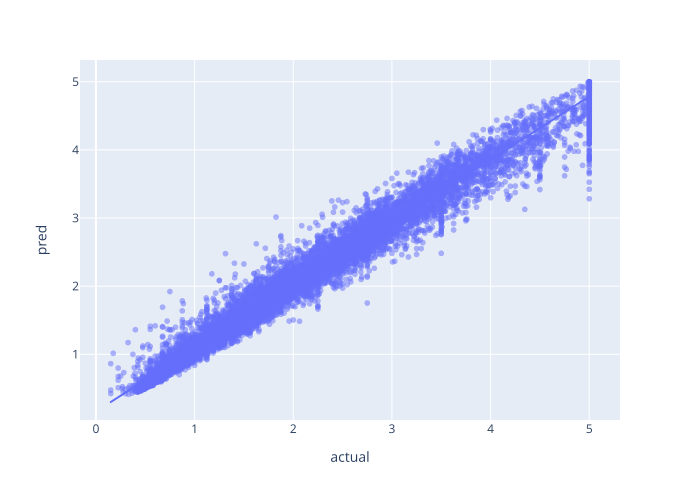

In [210]:
q = pd.DataFrame(data = {'actual':y_train,'pred':rf_pred_train})

px.scatter(q, x = 'actual',y = 'pred',trendline='ols', opacity=.5).show('svg')